## Writing Assignment - CS328: Introduction to Data Science
Team: Hype Squad

Members:
- Harinarayan J (23110128)
- Siddhesh Umarjee (23110347)
- Shounak Ranade (23110304)
- Dhruv Jalan (23110099)

## Topic

### Effects of Economy, natural resources distribution, and government policies on CO₂ emissions by countries



## Dataset Imports

In [ ]:
!ls WorldCarbonPricingDatabase/_dataset

data  sources


In [ ]:
import pandas as pd
import plotly.express as px
data_url = "https://raw.githubusercontent.com/owid/co2-data/refs/heads/master/owid-co2-data.csv"
codebook_url = "https://raw.githubusercontent.com/owid/co2-data/refs/heads/master/owid-co2-codebook.csv"
df = pd.read_csv(data_url)

In [ ]:
print(df.columns)

Index(['country', 'year', 'iso_code', 'population', 'gdp', 'cement_co2',
       'cement_co2_per_capita', 'co2', 'co2_growth_abs', 'co2_growth_prct',
       'co2_including_luc', 'co2_including_luc_growth_abs',
       'co2_including_luc_growth_prct', 'co2_including_luc_per_capita',
       'co2_including_luc_per_gdp', 'co2_including_luc_per_unit_energy',
       'co2_per_capita', 'co2_per_gdp', 'co2_per_unit_energy', 'coal_co2',
       'coal_co2_per_capita', 'consumption_co2', 'consumption_co2_per_capita',
       'consumption_co2_per_gdp', 'cumulative_cement_co2', 'cumulative_co2',
       'cumulative_co2_including_luc', 'cumulative_coal_co2',
       'cumulative_flaring_co2', 'cumulative_gas_co2', 'cumulative_luc_co2',
       'cumulative_oil_co2', 'cumulative_other_co2', 'energy_per_capita',
       'energy_per_gdp', 'flaring_co2', 'flaring_co2_per_capita', 'gas_co2',
       'gas_co2_per_capita', 'ghg_excluding_lucf_per_capita', 'ghg_per_capita',
       'land_use_change_co2', 'land_use_chang

In [ ]:
!git clone https://github.com/g-dolphin/WorldCarbonPricingDatabase.git

Cloning into 'WorldCarbonPricingDatabase'...
remote: Enumerating objects: 13801, done.
remote: Counting objects: 100% (1049/1049), done.
remote: Compressing objects: 100% (611/611), done.
remote: Total 13801 (delta 741), reused 547 (delta 437), pack-reused 12752 (from 2)
Receiving objects: 100% (13801/13801), 268.48 MiB | 16.30 MiB/s, done.
Resolving deltas: 100% (10380/10380), done.
Updating files: 100% (1216/1216), done.


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
data_url = "https://raw.githubusercontent.com/owid/co2-data/refs/heads/master/owid-co2-data.csv"
codebook_url = "https://raw.githubusercontent.com/owid/co2-data/refs/heads/master/owid-co2-codebook.csv"
df = pd.read_csv(data_url)
df2 = pd.read_csv(codebook_url)
df_US = df[df['country']=='United States']
df_IND = df[df['country']=='India']
df_CH = df[df['country']=='China']

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving ghg-emissions.csv to ghg-emissions (6).csv


In [ ]:
import pandas as pd
import glob
import plotly.express as px

# Step 1: Load and combine all CSVs
csv_files = glob.glob("WorldCarbonPricingDatabase/_dataset/data/CO2/national/wcpd_co2_*.csv")
carbon_tax_df = pd.concat((pd.read_csv(f) for f in csv_files), ignore_index=True)

# Step 2: Filter for carbon taxes and relevant columns
carbon_tax_df = carbon_tax_df[carbon_tax_df['tax'] == 1]
carbon_tax_df = carbon_tax_df[['jurisdiction', 'year', 'tax_rate_incl_ex_clcu', 'tax_curr_code']].dropna(subset=['tax_rate_incl_ex_clcu'])

# Step 3: Convert year to numeric and sort
carbon_tax_df['year'] = pd.to_numeric(carbon_tax_df['year'], errors='coerce').astype(int)
carbon_tax_df = carbon_tax_df.sort_values(['year', 'jurisdiction'])

# Step 4: Map jurisdictions to ISO3 (manual dictionary)
country_to_iso = {
    'United States': 'USA', 'Canada': 'CAN', 'China': 'CHN', 'India': 'IND', 'Russia': 'RUS',
    'Brazil': 'BRA', 'Australia': 'AUS', 'Germany': 'DEU', 'France': 'FRA', 'Japan': 'JPN',
    'United Kingdom': 'GBR', 'South Korea': 'KOR', 'Mexico': 'MEX', 'South Africa': 'ZAF',
    'Italy': 'ITA', 'Spain': 'ESP', 'Turkey': 'TUR', 'Saudi Arabia': 'SAU', 'Argentina': 'ARG',
    'Indonesia': 'IDN', 'Netherlands': 'NLD', 'Poland': 'POL', 'Belgium': 'BEL', 'Sweden': 'SWE',
    'Norway': 'NOR', 'Denmark': 'DNK', 'Finland': 'FIN', 'Switzerland': 'CHE', 'Austria': 'AUT'
    # Add more mappings as required
}
carbon_tax_df['iso_alpha'] = carbon_tax_df['jurisdiction'].map(country_to_iso)
carbon_tax_df = carbon_tax_df.dropna(subset=['iso_alpha'])


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving co2-emissions-vs-gdp.csv to co2-emissions-vs-gdp.csv


In [ ]:
df_ = pd.read_csv("co2-emissions-vs-gdp.csv")

In [ ]:
from google.colab import files
uploaded = files.upload()


Saving dfhsw_GRD_public_v1.dta to dfhsw_GRD_public_v1.dta


In [ ]:
file_path = "/content/dfhsw_GRD_public_v1.dta"
df = pd.read_stata(file_path)
resource = df['resource'].dropna().unique()


## About $CO_2$ emissions and dataset

The dataset used by us here is mainly highlighting comparisons of CO2 emissions vs several other parameters, these parameters will be used to strengthen our claims and settle hypothesis. \\
A brief about $CO_2$ emissions: \\
Carbon dioxide emissions are the primary driver of global climate change.
It's widely recognized that to avoid the worst impacts of climate change, the world needs to urgently reduce emissions. But, how this responsibility is shared between regions, countries, and individuals has been an endless point of contention in international discussions. \\
To evaluate $CO_2$ and effects of economy, natural resources distribution and government policies, several parameters and datasets have been used to produce comparisons and strengthen hypothesis.

The data in this assignment is extracted from these following datasets: \\
[Dataset 1](https://github.com/owid/co2-data) \\
[Dataset 2](https://github.com/g-dolphin/WorldCarbonPricingDatabase/tree/main/_dataset/data/CO2/national) \\
[Reference Website 1](https://www.wri.org/insights/history-carbon-dioxide-emissions#:~:text=Carbon%20dioxide%20(CO2)%20emissions%20from,the%20Industrial%20Revolution%20was%20underway.) \\
[Reference Website 2](https://www.climatewatchdata.org/data-explorer/historical-emissions?historical-emissions-data-sources=climate-watch&historical-emissions-gases=all-ghg&historical-emissions-regions=All%20Selected&historical-emissions-sectors=total-including-lucf%2Ctotal-including-lucf&page=1)



## Overview of $CO_2$ emission over time

Summary: \\
$CO_2$ emission has only grown over time with some minor drops in some years. Here, we aim to analyze the minor drops and their reasons.

Hypothesis: \\
There are several instances when world problems have caused the $CO_2$ emissions to drop.

Analyzing and Settling the Hypothesis: \\
The period between 1919 - 1945 when the 2 world wars were fought, $CO_2$ emissions dropped. The COVID-19 period caused a drop in $CO_2$ emission.

Verdict:
When humans are disturbed from their normal routine, such as in times of crises or diseases, $CO_2$ emission reduces.



In [ ]:
# @title Global $CO_2$ Emissions over time
global_emissions = df.groupby('year')['co2'].sum().reset_index()
fig = px.line(global_emissions, x='year', y='co2',
              title='Global CO₂ Emissions Over Time',
              labels={'co2': 'CO₂ Emissions (million tonnes)', 'year': 'Year'})
fig.show()

In [ ]:
# @title $CO_2$ Emissions vs Population
# Plotting emissions vs. GDP growth
fig = px.scatter(countries_df, x='population', y='co2', color='country',
                title='CO₂ Emissions vs. Population (1990-2020)',
                labels={'gdp': 'GDP (USD)', 'co2': 'CO₂ Emissions (million tonnes)'})
# Set only United States, India, and China visible by default
countries_on = {'United States', 'India', 'China'}
for trace in fig.data:
    if trace.name not in countries_on:
        trace.visible = 'legendonly'
fig.show()

## Overview of $CO_2$ emissions over time, by country

In [ ]:
#@title Top 10 countries by emission over the years
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.colors as mcolors
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Load the dataset
url = "https://raw.githubusercontent.com/owid/co2-data/refs/heads/master/owid-co2-data.csv"
df = pd.read_csv(url)

# Filter relevant data: exclude world/regions and keep only countries
df = df[df['iso_code'].apply(lambda x: isinstance(x, str) and len(x) == 3)]

# Focus on country, year, and co2
df = df[['country', 'year', 'co2']].dropna()

# Only keep positive emissions
df = df[df['co2'] > 0]

# Prepare dataframe for animation: rank top N countries per year
top_n = 10
def prepare_year(df, year):
    dff = df[df['year'] == year].sort_values(by='co2', ascending=False).head(top_n)
    dff = dff[::-1]  # Flip for barh
    return dff

years = sorted(df['year'].unique())
fig, ax = plt.subplots(figsize=(10, 6))

special_color = {
    'China': 'red',
    'United States': 'skyblue',
    'India': 'orange',
    'Russia': 'purple',
    'Japan': 'pink',
    'Iran': 'maroon',
    'Germany': 'teal',
    'Saudi Arabia': 'darkgreen',
    'Indonesia': 'gold',
    'South Korea': 'teal'
}

# Generate base colors
unique_countries = df['country'].unique()
palette = list(mcolors.TABLEAU_COLORS.values()) + list(mcolors.CSS4_COLORS.values())

# Assign colors
country_colors = {}
for i, country in enumerate(unique_countries):
    if country in special_color:
        country_colors[country] = special_color[country]
    else:
        country_colors[country] = palette[i % len(palette)]

def update(year):
    ax.clear()
    dff = prepare_year(df, year)
    colors = [country_colors[c] for c in dff['country']]
    ax.barh(dff['country'], dff['co2'], color=colors)
    ax.set_title(f"Top {top_n} CO₂ Emitting Countries - {year}", fontsize=16)
    ax.set_xlabel("CO₂ Emissions (million tonnes)")
    ax.set_xlim(0, df['co2'].max() * 1.1)
    ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{x:,.0f}'))
    for i, (value, name) in enumerate(zip(dff['co2'], dff['country'])):
        ax.text(value, i, f'{value:,.0f}', va='center', ha='left')
    plt.tight_layout()

# Create animation
ani = FuncAnimation(fig, update, frames=years, repeat=False, interval=75)

# Display in notebook
plt.close(fig)
HTML(ani.to_jshtml())


<Figure size 640x480 with 0 Axes>

In [ ]:
# @title $CO_2$ emissions by Country over time
fig = px.line(countries_df, x='year', y='co2', color='country',
              title='CO₂ Emissions by Country Over Time',
              labels={'co2': 'CO₂ Emissions (million tonnes)', 'year': 'Year'},
              hover_name='country')
fig.update_layout(showlegend=False)
fig.show()

## Effect of economy on Carbon Emission rate

To show the effect of economy on $CO_2$ emission, we have used the comparison of GDP vs $CO_2$ emission. According to the plots, it is clear from the trends that countries which have a higher GDP result in a higher $CO_2$ emission. Hence, we can directly link the two. \\
Using the below visual we can see countries moving almost linearly on the GDP vs $CO_2$ emission graph. As the years progress, the bubble (indicating population) grows, along with the GDP and $CO_2$ emission in almost a linear manner. \\
We can also make a rough estimate that $$CO_2 = A. GDP$$
This is a rough estimate summarizing all the data visualization.

According to my initial hypothesis, countries with higher GDPs, have a higher carbon emission.

In [ ]:
# @title Year vs $CO_2$ and $CO_2$ per capita emissions
import pandas as pd
import plotly.express as px

# Filter valid data first
filtered_df = countries_df[
    (countries_df['iso_code'].str.len() == 3) &
    countries_df['co2'].notnull() &
    countries_df['gdp'].notnull() &
    countries_df['population'].notnull()
].copy()
# Ensure 'year' is numeric and within a valid range
filtered_df['year'] = pd.to_numeric(filtered_df['year'], errors='coerce')
filtered_df = filtered_df.dropna(subset=['year'])
filtered_df = filtered_df[(filtered_df['year'] >= 1950) & (filtered_df['year'] <= 2025)]
filtered_df['year'] = filtered_df['year'].astype(int)
# Sort by year for good measure (not strictly needed, but cleaner)
filtered_df = filtered_df.sort_values(by='year')
# Create animated plot
fig = px.scatter(
    filtered_df,
    x="gdp",
    y="co2",
    size="population",
    color="country",
    hover_name="country",
    animation_frame="year",
    animation_group="country",
    title="CO₂ Emissions vs GDP Over Time (Size = Population)",
    labels={
        "gdp": "GDP (USD)",
        "co2": "CO₂ Emissions (million tonnes)",
        "population": "Population"
    },
    size_max=60,
    log_x=True,
    log_y=True,
    range_x=[1e3, 1e15],
    range_y=[1, 1e10]
)
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 100
fig.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 80
fig.show()

In [ ]:
# @title $CO_2$ emissions and GDP
fig = px.scatter(countries_df, x='gdp', y='co2', color='country',
                title='CO₂ Emissions vs. GDP Growth (1990-2020)',
                labels={'gdp': 'GDP (USD)', 'co2': 'CO₂ Emissions (million tonnes)'})
fig.show()

### Diving deep into GDP vs $CO_2$ comparison

Hypothesis: \\
A countrys total $CO_2$ emissions are directly proportional to its GDP, this is my initial hypothesis.

Quantifying the Hypothesis: \\
Initially, we observe China as the largest emitter of $CO_2$, which seems to support the hypothesis. But when we consider population and we obtain $CO_2$ emissions per capita,  we can see some interesting trends. USA has a much higher $CO_2$ emission per capita GDP in comparison to China and India.

Analyzing and Settling the Hypothesis: \\
Looking at the GDP vs $CO_2$ comparison we made an initial judgement. But when, compared with population we could see a huge disparity. The world's strongest economy USA has the highest $CO_2$ emission per capita. Here my initial hypothesis of directly comparing GDP and $CO_2$ emission fails. According to that hypothesis, highest $CO_2$ emitter is China, hence it is a strong economy. \\
This is not the case. As seen in the below plots, it shows that when population is factored in, USA clearly stands out from all the other countries hence looking at the data, we can comment that USA is the strongest economy as it has the highest $CO_2$ emission per capita GDP. This also fails our initial hypothesis. When we divide emissions by population, we get a better idea of individual or per person impact.

Final Verdict: \\
When looking in economy terms, we can clearly see that country with a higher per capita GDP has higher $CO_2$ emission.
Basically, richer people emit more $CO_2$ more than their poorer counterparts.


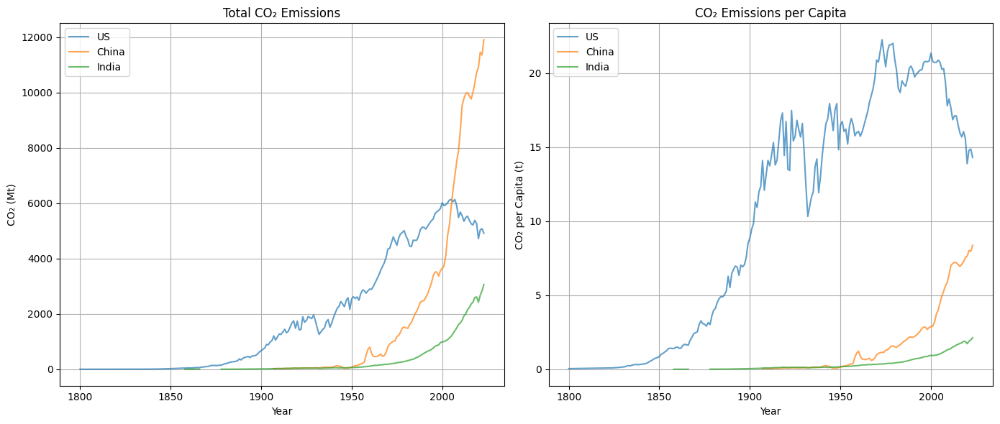

In [ ]:
# @title Year vs $CO_2$ and $CO_2$ per capita emissions
# Drop rows with missing values
df = df.dropna()
# Create figure and subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharex=True)
# First subplot: Total CO₂ emissions
axes[0].plot(df_US['year'], df_US['co2'], alpha=0.7, label='US')
axes[0].plot(df_CH['year'], df_CH['co2'], alpha=0.7, label='China')
axes[0].plot(df_IND['year'], df_IND['co2'], alpha=0.7, label='India')
axes[0].set_title('Total CO₂ Emissions')
axes[0].set_xlabel('Year')
axes[0].set_ylabel('CO₂ (Mt)')
axes[0].grid(True)
axes[0].legend()

# Second subplot: CO₂ per capita
axes[1].plot(df_US['year'], df_US['co2_per_capita'], alpha=0.7, label='US')
axes[1].plot(df_CH['year'], df_CH['co2_per_capita'], alpha=0.7, label='China')
axes[1].plot(df_IND['year'], df_IND['co2_per_capita'], alpha=0.7, label='India')
axes[1].set_title('CO₂ Emissions per Capita')
axes[1].set_xlabel('Year')
axes[1].set_ylabel('CO₂ per Capita (t)')
axes[1].grid(True)
axes[1].legend()

plt.tight_layout()
plt.show()


---

## Effect of Natural Resource Distribution On $CO_2$ emission

Summary of Data we shall use for hypothesis: \\
The data consists of two broad categories, one is of natural resource distribution, where I have picked 4 main resources, Coal, Natural Gas, oil and LPG. These are the principal emitters of $CO_2$ by natural resource. The second dataset we have used is $CO_2$ emissions per capita vs GDP per capita. This is to facilitate my further hypothesis.

Hypothesis: \\
According to my basic hypothesis, countries which have more natural resources have a higher $CO_2$ emission. Since more natural resources which emit $CO_2$ are found in this region, more $CO_2$ will be emitted in these regions.

Quantifying my hypothesis: \\
My hypothesis is a linear relation between Natural Resources and $CO_2$ emission.

Analyzing and Settling my hypothesis: \\
Deep diving into the data, we looked at the countries with the highest natural resource distribution and traced them on $CO_2$ emission per capita vs GDP per capita. This clearly failed our initial hypothesis. The graph clearly shows that the initial hypothesis is not true and there is no such linear relation between the natural resource distribution and $CO_2$ emission. \\
This hypothesis fails for countries like Brazil, Indonesia, South Africa but it is not failing for countries such as Saudi Arabia, Kuwait which are one of the top most countries in the graph. \\

Reason:
Saudi Arabia, Kuwait are countries which have wisely capitalized on their abundant availability of natural resources, hence improved their economy drastically, which is evident from the $CO_2$ emission.

Countries such as Indonesia, Brazil, South Africa have underutilized natural resources. They will only move higher in the $CO_2$ emission vs GDP per capita graph as they start to utilize more and more resources. \\

Russia on the other hand, is much more balanced. It has a fairly high position in the below graph and also abundant natural resources.

Verdict: \\
Looking at data, and testing my hypothesis, I can say with confidence that the distribution of Natural Resources affects the $CO_2$ emission, but it is very country specific, which means it depends on how each country utilizes its resources and generates income.

In [ ]:
# @title Carbon, Oil, Natural Gas, LPG distribution by countries
import pandas as pd
import plotly.express as px


# Define carbon-emitting resources (edit this list as needed)
carbon_resources = ['coal','oil', 'natural gas', 'liquified petroleum gas' ]

# Step 1: Filter dataset
df_carbon = df[
    df['resource'].isin(carbon_resources) &
    df['country'].notnull()
]

# Step 2: Count carbon resource occurrences per country
carbon_counts = df_carbon.groupby('country')['resource'].count().reset_index()
carbon_counts.columns = ['country', 'carbon_resource_count']
carbon_counts = carbon_counts.sort_values(by='carbon_resource_count', ascending=False)

# Step 3: Bar chart of top 20 countries
fig_bar = px.bar(
    carbon_counts.head(20),
    x='country',
    y='carbon_resource_count',
    title='Top 20 Countries by Number of Carbon Resource Entries',
    labels={'carbon_resource_count': 'Carbon Resource Count'},
    text='carbon_resource_count'
)
fig_bar.update_layout(xaxis_tickangle=-45)
fig_bar.show()

# Step 4: Choropleth map
fig_choropleth = px.choropleth(
    carbon_counts,
    locations='country',
    locationmode='country names',
    color='carbon_resource_count',
    color_continuous_scale='Reds',
    title='Global Distribution of Carbon Resource Occurrences',
    labels={'carbon_resource_count': 'Carbon Resource Count'}
)
fig_choropleth.show()

In [ ]:
# @title $CO_2$ emissions per capita vs GDP per capita
import plotly.express as px

fig = px.scatter(
    df_,
    x="GDP per capita",
    y="Annual CO₂ emissions (per capita)",
    color="Entity",
    size="Population (historical)",
    hover_name="Entity",
    animation_frame="Year",
    title="CO₂ Emissions per Capita vs GDP per Capita Over Time",
    labels={
        "GDP per capita": "GDP per Capita (USD)",
        "Annual CO₂ emissions (per capita)": "CO₂ Emissions per Capita (tons)"
    }
)
fig.add_annotation(
    x=df_[df_["Entity"] == "Brazil"]["GDP per capita"].values[0],
    y=df_[df_["Entity"] == "Brazil"]["Annual CO₂ emissions (per capita)"].values[0],
    text="brazil",
    showarrow=True,
    arrowhead=2
)
fig.add_annotation(
    x=df_[df_["Entity"] == "South Africa"]["GDP per capita"].values[0],
    y=df_[df_["Entity"] == "South Africa"]["Annual CO₂ emissions (per capita)"].values[0],
    text="south africa",
    showarrow=True,
    arrowhead=2
)
fig.add_annotation(
    x=df_[df_["Entity"] == "Indonesia"]["GDP per capita"].values[0],
    y=df_[df_["Entity"] == "Indonesia"]["Annual CO₂ emissions (per capita)"].values[0],
    text="indonesia",
    showarrow=True,
    arrowhead=1
)
fig.add_annotation(
    x=df_[df_["Entity"] == "Saudi Arabia"]["GDP per capita"].values[0],
    y=df_[df_["Entity"] == "Saudi Arabia"]["Annual CO₂ emissions (per capita)"].values[0],
    text="saudi",
    showarrow=True,
    arrowhead=1
)
fig.add_annotation(
    x=df_[df_["Entity"] == "Kuwait"]["GDP per capita"].values[0],
    y=df_[df_["Entity"] == "Kuwait"]["Annual CO₂ emissions (per capita)"].values[0],
    text="kuwait",
    showarrow=True,
    arrowhead=1
)
fig.add_annotation(
    x=df_[df_["Entity"] == "Russia"]["GDP per capita"].values[0],
    y=df_[df_["Entity"] == "Russia"]["Annual CO₂ emissions (per capita)"].values[0],
    text="Russia",
    showarrow=True,
    arrowhead=1
)
fig.update_layout(showlegend=False)
fig.show()


## Effect of Government Policies on Carbon Emission Rate

Our hypothesis states: \\
When the government implemented $CO_2$ tax, it brought down the $CO_2$ emission. Governments that took early steps in implementing carbon taxes aimed to financially disincentivize excessive carbon emissions, thereby encouraging industries and individuals to shift towards cleaner technologies and practices. This mechanism directly aligns economic interests with environmental goals, fostering sustainable development.

Quantifying Hypothesis: \\
When we observe the scandinavian countries, we can clearly see the change in its tax system brought after 1990. This has directly impacted the $CO_2$ emission rate, we can see a falling rate. The drop is not only in absolute emissions but also in the growth rate of emissions over time. These countries maintained or improved economic performance while simultaneously reducing emissions, proving that economic growth and environmental responsibility are not mutually exclusive.

Analyzing and settling the hypothesis: \\
In a more populous country like Japan, change is shown slowly, as observed in the Carbon Emission rate plot below. We have taken two countries, India, and United Arab Emirates (one highly populous and one moderately populated). Here, we can see an increasing trend of $CO_2$ emission, because there is no tax policy implemented. These examples highlight the importance of policy timing and enforcement strength. \\
From this, we can conclude that countries which have introduced carbon tax have managed to bring down their $CO_2$ emission. The correlation between policy action and emission trend is strongly supported by visual and numerical data.

Final Verdict: \\
After comparing both the plots below. It is very clear that when the government intervened with its policies, it caused change. These findings support the hypothesis and advocate for broader implementation of similar climate policies worldwide.


In [ ]:
# @title Emissions by Countries where $CO_2$ tax has been implemented
# Define the list of Scandinavian countries
scandinavian_countries = ['Sweden', 'Norway', 'Denmark','Japan', 'Argentina', 'Mexico', 'South Africa', 'India', 'United Arab Emirates']
# Filter the DataFrame to include only those countries
scandinavian_df = countries_df[countries_df['country'].isin(scandinavian_countries)]
# Create the line plot
fig = px.line(
    scandinavian_df,
    x='year',
    y='co2',
    color='country',
    title='CO₂ Emissions ',
    labels={'co2': 'CO₂ Emissions (million tonnes)', 'year': 'Year'},
    hover_name='country'
)
# Optional: show legend if you want to differentiate countries
fig.update_layout(showlegend=True)
fig.show()


In [ ]:
# @title Carbon Tax Rate by country over time
import plotly.express as px
year_order = sorted(carbon_tax_df['year'].unique())
fig = px.choropleth(
    carbon_tax_df,
    locations="iso_alpha",
    color="tax_rate_incl_ex_clcu",
    hover_name="jurisdiction",
    animation_frame="year",
    category_orders={"year": year_order},
    color_continuous_scale=px.colors.sequential.Purples,
    title="Carbon Tax Rate by Country Over Time",
    labels={"tax_rate_incl_ex_clcu": "Tax Rate (incl. exclu.)"}
)
fig.update_layout(
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type="natural earth",
    ),
    title_x=0.5,
    margin=dict(l=10, r=10, t=50, b=10),
    coloraxis_colorbar=dict(
        title="Tax Rate",
        ticksuffix=" USD/tCO₂",
        len=0.75
    ),
    updatemenus=[{
        "type": "buttons",
        "showactive": False,
        "x": 0.05,
        "y": 0,
        "xanchor": "right",
        "yanchor": "top",
        "direction": "left",
        "pad": {"r": 10, "t": 75},
        "buttons": [
            {
                "label": "Play",
                "method": "animate",
                "args": [None, {
                    "frame": {"duration": 800, "redraw": True},
                    "fromcurrent": True,
                    "transition": {"duration": 300, "easing": "quadratic-in-out"}
                }]
            },
            {
                "label": "Pause",
                "method": "animate",
                "args": [[None], {
                    "frame": {"duration": 0, "redraw": False},
                    "mode": "immediate"
                }]
            }
        ]
    }]
)
fig.update_traces(marker_line_width=0.5)
fig.update_layout(
    sliders=[{
        "active": 0,
        "yanchor": "top",
        "xanchor": "left",
        "currentvalue": {
            "prefix": "Year: ",
            "font": {"size": 20}
        }
    }]
)
fig.show()

## Conclusion

Using visualization by importing datasets and making suitable plots, we have analyzed 3 main parameters, effect of economy on the $CO_2$ emission, effect of Natural resources distribution, and effect of government policies. \\
For each case, we have given a comprehensive analysis, and hypothesis. The hypothesis is then tested. Once that happens, we have given the final verdict based on the data analyzed by us. \\







